# **1.Problem Analysis** 

The problem is to find the electricity consumed inside the house depending on various factors. From the dataset, energy consumption is influenced by datetime,temperature, humidity, windspeed, lights, Tdewpoint and pressure and  appliances being the the target variable. As we have to train our models based on a labelled training data, and the values for all the features are continuous, this is a supervised regression probelm.

The evaluation metric used is the Root mean squared error (RMSE) which is calculated by the square root of the mean of the square of all of the errors. The lower the RMSE value, the better is the model performance. Thus, the RMSE should be minimised.

In [1]:
#IMPORT THE LIBRARIES
import numpy as np
import pandas as pd
import sklearn
import time
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import learning_curve
from sklearn.metrics import explained_variance_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import validation_curve
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import plot_roc_curve
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import Pipeline
import warnings
warnings.filterwarnings("ignore")

In [2]:
#load the data
data_folder = "C:/Users/Deepika Chandrababu/Desktop/ML project/dataset/"
train_data = pd.read_csv(data_folder + "train.csv")
test_data = pd.read_csv(data_folder + "test.csv")

In [3]:
df_train = train_data
df_test = test_data

In [4]:
def generate_unique_filename(basename, file_ext):
    """Adds a timestamp to filenames for easier tracking of submissions, models, etc."""
    timestamp = time.strftime("%Y%m%d-%H%M%S", time.localtime())
    return basename + '_' + timestamp + '.' + file_ext

# **2. Data Analysis**

The date column has a time series data. All the other features are continuous in interval scale. 

In [28]:
df_train.head()

,date,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,Visibility,Tdewpoint,rv1,rv2,Appliances,day,month,year,hour,week
0,2016-01-11 17:00:00,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,45.566667,...,63.000000,5.3,13.275433,13.275433,60,11,1,2016,17,2
1,2016-01-11 17:10:00,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,45.992500,...,59.166667,5.2,18.606195,18.606195,60,11,1,2016,17,2
2,2016-01-11 17:20:00,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,45.890000,...,55.333333,5.1,28.642668,28.642668,50,11,1,2016,17,2
3,2016-01-11 17:30:00,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,45.723333,...,51.500000,5.0,45.410389,45.410389,50,11,1,2016,17,2
4,2016-01-11 17:40:00,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,45.530000,...,47.666667,4.9,10.084097,10.084097,60,11,1,2016,17,2


# Checking for NA 
As we can see below there are no missing values in any of the columns. Also, all columns have 15000 values which means the dataset is balanced. The date column is of type object which has to be converted to find meaningful insights.

In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15000 entries, 0 to 14999
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         15000 non-null  object 
 1   lights       15000 non-null  int64  
 2   T1           15000 non-null  float64
 3   RH_1         15000 non-null  float64
 4   T2           15000 non-null  float64
 5   RH_2         15000 non-null  float64
 6   T3           15000 non-null  float64
 7   RH_3         15000 non-null  float64
 8   T4           15000 non-null  float64
 9   RH_4         15000 non-null  float64
 10  T5           15000 non-null  float64
 11  RH_5         15000 non-null  float64
 12  T6           15000 non-null  float64
 13  RH_6         15000 non-null  float64
 14  T7           15000 non-null  float64
 15  RH_7         15000 non-null  float64
 16  T8           15000 non-null  float64
 17  RH_8         15000 non-null  float64
 18  T9           15000 non-null  float64
 19  RH_9

# **Univariate Analysis**

The values of lights are mostly left skewed from 0 to 20 where 0 values could impose 0 energy consumption. The temperature features from T1 to T8 ranges from 17 to 25 and are mostly normally distributed except for T9 which is slightly left skewed but has the values between 15 to 25. The room humidity of RH_1 to RH_4, RH_7, RH_8, RH_9 are from 30 to 50 which are normally distributed. RH_5 is left skewed having values between 40 to 60 and RH_6 is right skewed where most of the values are from 50 to 100. T_Out is normally distributed betweem negative values and 20. The pressure from weather station averages between 740 to 760. The humidity outside the building (RH_out) is right skewed having most values in 90. The windspeed does not appear to have much data since all the values are between 0 to 10 being left skewed. Tdewpoint is normally distributed. 

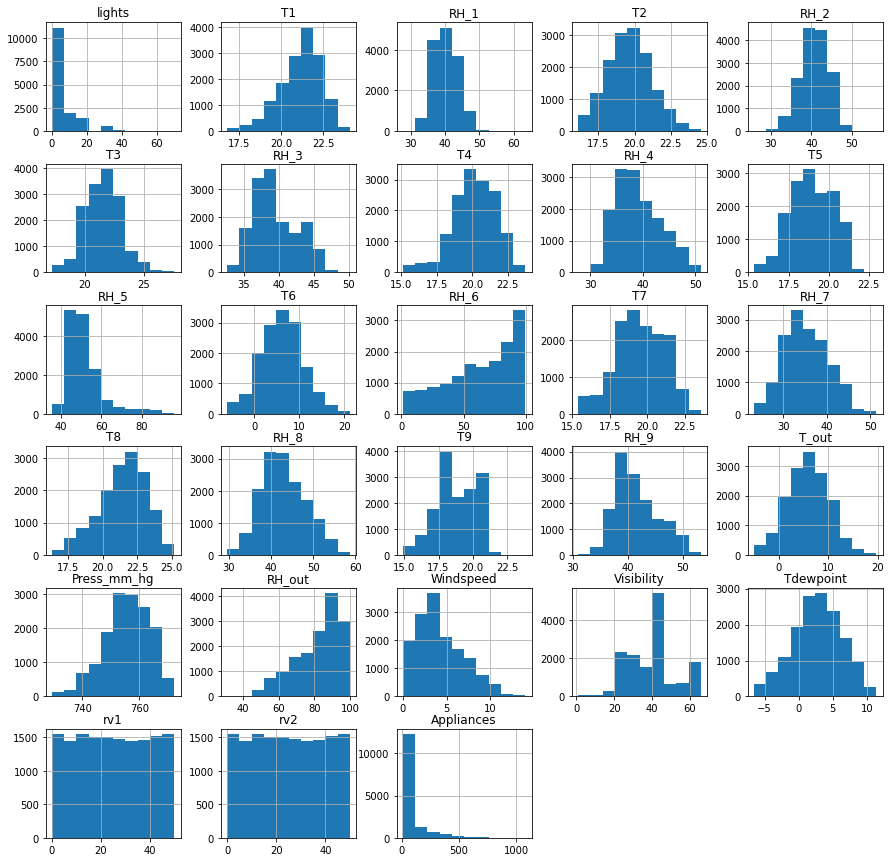

In [ ]:
df_train.hist(figsize = (15,15)) 
plt.show()

Here, The values for Appliances fall between 0 to 500 but the maximum of appliance value is 1080 and 1070 but immediately drops down to 970 which is seen in the below table. Since it is our target variable it is essential to look at the most appearing values in a boxplot to better understand the outliers. 

## Checking for outliers

It is seen that 1080 is an outlier and there are no values between 900 to 1000. Even though if there are outliers, the models were performing good without removing them.

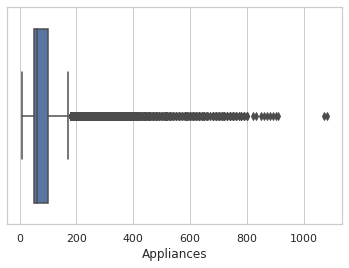

In [ ]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df_train["Appliances"])

## Correlation between all the features


From the heatmap, it is seen that there are a few high correlation between some features as the scale goes from -0.6 to 1.0. However most of the features range between 0.2 to -0.6 which indicate they are not highly correlated. Future dimensionality reduction will be needed for better performance.

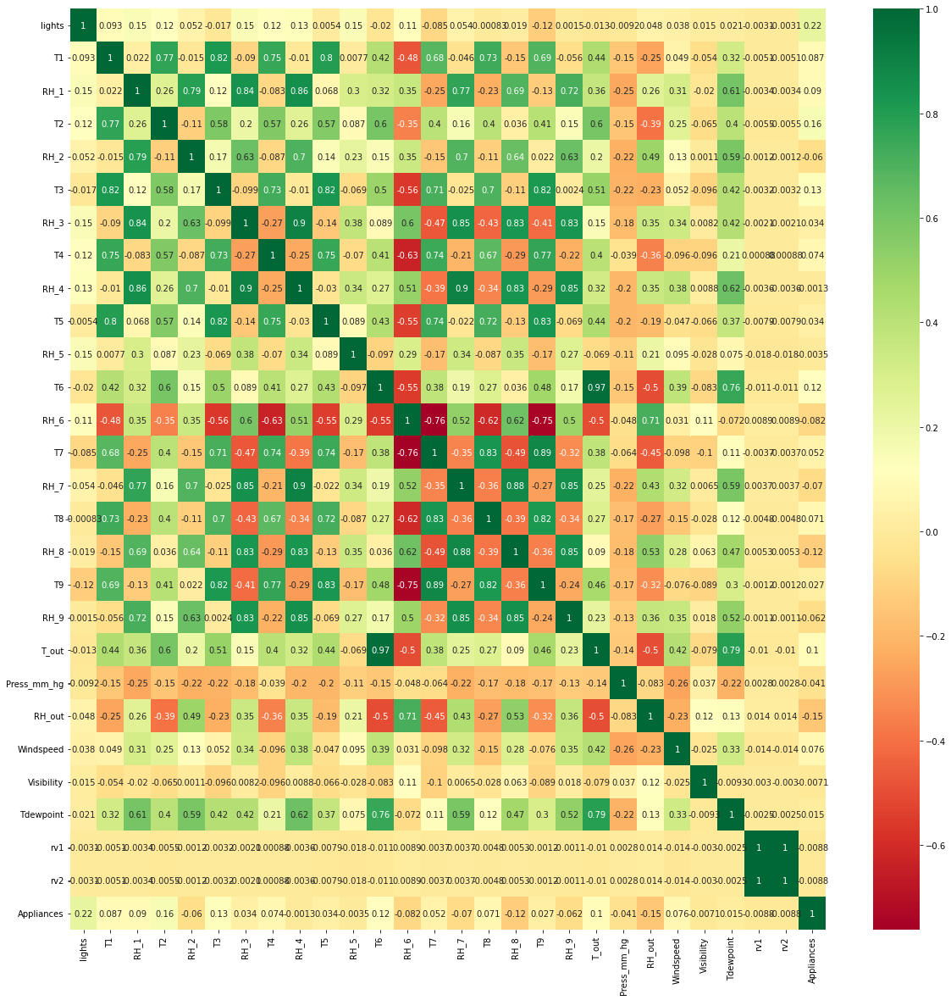

In [ ]:
corrmap = df_train.corr()
corr_features = corrmap.index
plt.figure(figsize=(15,15))
df_train_heatmap = sns.heatmap(df_train[corr_features].corr(),annot=True,cmap="RdYlGn")


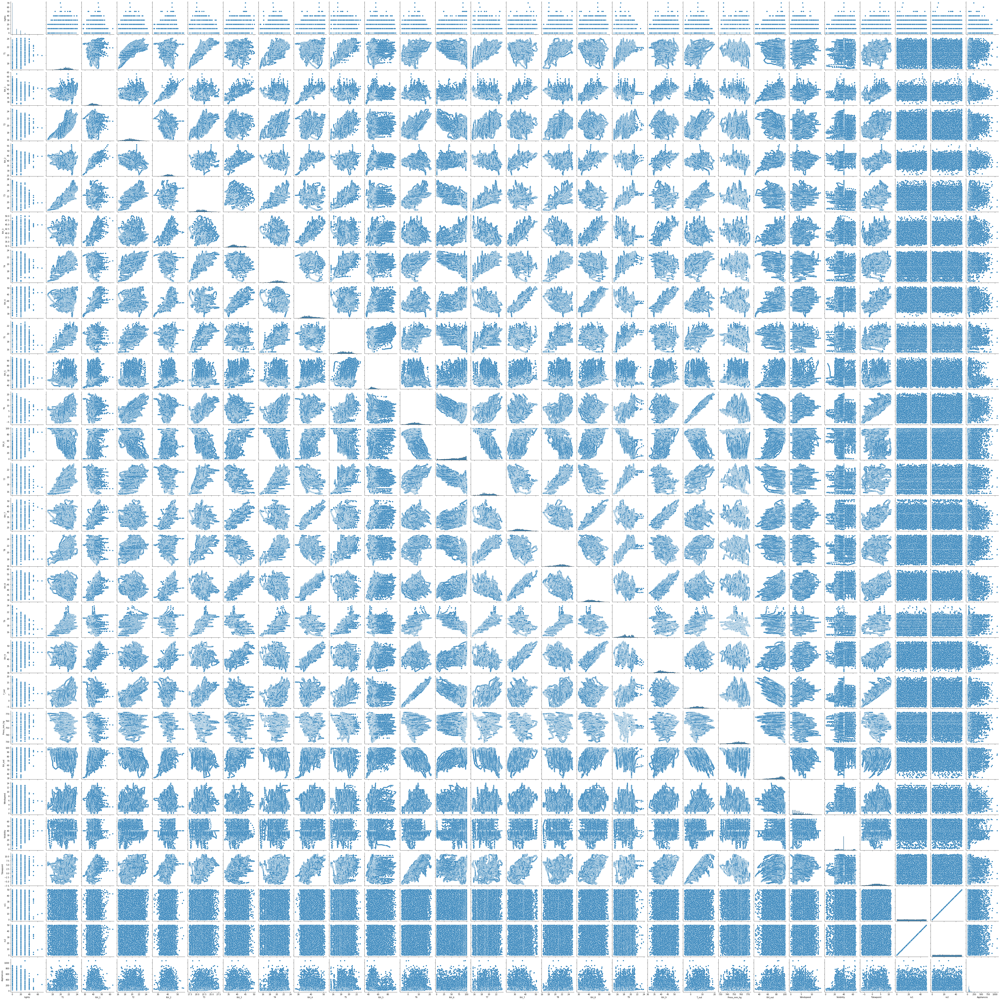

In [ ]:
sns.pairplot(df_train)

# 3.Feature Extraction


From the date column, useful information is extracted in the form of consumption during every hour, weekdays and month as these factors depend on the need of electricity. 

In [5]:
# extracting hour and days from date column for useful insights
import datetime as dt
df_train["date"] = pd.to_datetime(df_train["date"])
df_train["day"] = df_train['date'].map(lambda x: x.day)
df_train["month"] = df_train['date'].map(lambda x: x.month)
df_train["year"] = df_train['date'].map(lambda x: x.year)
df_train["hour"] = df_train['date'].map(lambda x: x.hour)
df_train["week"] = df_train['date'].map(lambda x: x.week)

#https://stackoverflow.com/questions/41455967/convert-datetime-string-to-new-columns-of-day-month-year-in-pandas-data-frame
#doing the same on test data
df_test["date"] = pd.to_datetime(df_test["date"])
df_test["hour"] = df_test['date'].map(lambda x: x.hour)

Calculating the mean values for hour and minute it is clear that the energy consumed every 10 seconds does not make much difference

In [7]:
df_train.groupby([df_train["date"].dt.minute])[ "Appliances"].mean()

date
0      98.396
10     97.420
20     96.880
30     99.196
40    100.320
50    100.296
Name: Appliances, dtype: float64

The consumption is high from 8 to 21 hour, very high consumption occurs at 18 hour 

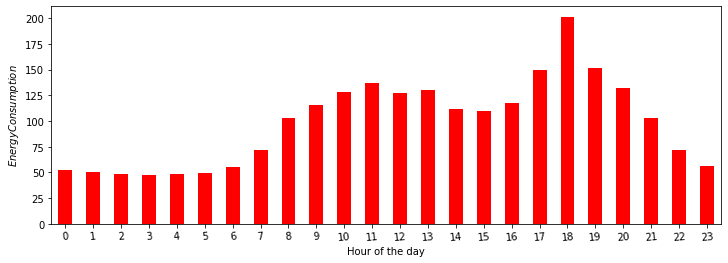

In [ ]:
fig, axs = plt.subplots(figsize=(12, 4))
df_train.groupby(df_train["date"].dt.hour)["Appliances"].mean().plot(kind='bar', rot=5, ax=axs, color=["red"])
plt.xlabel("Hour of the day"); 
plt.ylabel("$Energy Consumption$");


# 4.Feature Selection

Selecting features through variable importance after training a random forest model. Here, feature importance is calculated 
by the probability of the number of samples that reach the node, divided by the total number of samples. The higher the value the more important the feature.

In [ ]:
labels = np.array(df_train['Appliances'])
features= df_train.drop(['date', 'Appliances','Temperature','Humidity'], axis = 1)
feature_list = list(features.columns)
features = np.array(features)

In [ ]:
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)
#the features are balanced between train and test

Training Features Shape: (11241, 33)
Training Labels Shape: (11241,)
Testing Features Shape: (3748, 33)
Testing Labels Shape: (3748,)


In [ ]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
rf.fit(train_features, train_labels);
predictions = rf.predict(test_features)

In [ ]:
importances = list(rf.feature_importances_)
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)
[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances];

Variable: hour                 Importance: 0.27
Variable: T8                   Importance: 0.06
Variable: lights               Importance: 0.05
Variable: T3                   Importance: 0.05
Variable: Press_mm_hg          Importance: 0.04
Variable: RH_2                 Importance: 0.03
Variable: RH_3                 Importance: 0.03
Variable: T5                   Importance: 0.03
Variable: RH_5                 Importance: 0.03
Variable: T9                   Importance: 0.03
Variable: Tdewpoint            Importance: 0.03
Variable: T1                   Importance: 0.02
Variable: RH_1                 Importance: 0.02
Variable: T2                   Importance: 0.02
Variable: T4                   Importance: 0.02
Variable: RH_4                 Importance: 0.02
Variable: T6                   Importance: 0.02
Variable: RH_6                 Importance: 0.02
Variable: T7                   Importance: 0.02
Variable: RH_7                 Importance: 0.02
Variable: RH_8                 Importanc

Hour has the highest of 0.27 importance. To reduce the dimensions causing noise, lets consider the features that has an importance of atleast 0.3. Also, to quickly visualise the importance

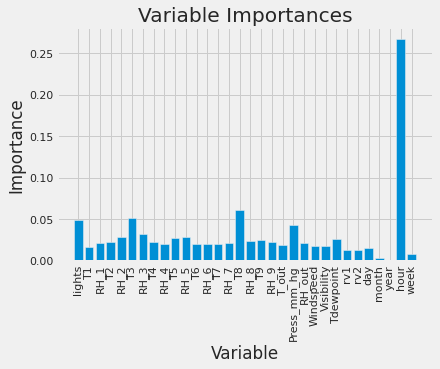

In [ ]:
plt.style.use('fivethirtyeight')
x_values = list(range(len(importances)))
plt.bar(x_values, importances, orientation = 'vertical')
plt.xticks(x_values, feature_list, rotation='vertical')
plt.ylabel('Importance'); plt.xlabel('Variable'); plt.title('Variable Importances');

Hour plays a major role in the electricity consumed. Other features such as lights, T3, T8, Press_mm_hg are also having an impact

# 5.Train/test split

From Kaggle, the dataset is already split into training and test data. The training data is further divided into training and validation data i.e 75% of the data will be used to train the model and the 25% will be used in testing which will also be used to compute the score of the performance metric. The lower the root mean squared error the better the model.
Also, setting a random state will generate same set of split every time since the data was collected randomly by means of web scraper.





The models did not perform well when the data is scaled using standard scaler. Hence standardising the features was not helpful and neglected in the pipeline.

In [6]:
# As a result of variable importance from random forest top 10 features are taken from the training and test set.
train = df_train.loc[:,['hour', 'T8', 'lights', 'T3', 'Press_mm_hg', 'RH_2', 'RH_3', 'T5', 'RH_5', 'T9', 'Tdewpoint']]
test_data = df_test.loc[:,['hour', 'T8', 'lights', 'T3', 'Press_mm_hg', 'RH_2', 'RH_3', 'T5', 'RH_5', 'T9', 'Tdewpoint']]
target = np.array(df_train['Appliances'])

In [7]:
test_fraction = 0.25
x_train, x_test, r_train, r_test = train_test_split(train, target, test_size = test_fraction,random_state = 10)
print(len(x_train))
print(len(x_test))

11250
3750


# **6.CrossValidation and Gridsearch**

Gridsearchcv is used to find the best hyperparameters; 

The library function GridSearchCV from sklearn works by trying all combinations of the values(hyperparameters) passed. For instance, it takes the model that should be fitted(neuralnetwork/RidgeRegressor/SVR), the dictionary of hyperparameters for the appropriate models, scoring(evaluation metric)- root mean squared error and the number of times cross validation should be performed. In our example, cv=10 means that cross validation will be performed ten times where in each fitting 90% of the data will be used for training and 10% of the data for validation. In each crossvalidation setting, the values passed in gridsearchcv will be evaluated with respect to the scoring/root mean squared error for every combination of the hyperparamters and the values with the best scores will be selected to tune the model.

# 7.Model Training and Hyperparameter Tuning

## Model 1

# Neural Network - MLP Regressor

MLP is a class of feed forward artificial neural network which refers to networks that has multiple layers of perceptrons. 
It has an input layer, hidden layers (which is connected by number of nodes) and a output layer. Each node in the hidden layer uses non linear activation functions. An MLP performs classification or regression based on its activation function. MLP uses backpropagation for training which calculates the gradient of the error function with respect to the neural network's weights. Fine tuning the weights reduces the error rate obtained in each iteration(epochs). Thus it decreaces the loss and makes the model more reliable.


### Fine tuned MLP Regressor outperformed other models with a kaggle score of 82.17


## Bias-Variance tradeoff for MLP

To check how MLPRegressor learns the given training data, it is divided into train and test scores and cross validated using 10 fold cross validation method and scored based on the given performance metric . 

In [9]:
X = train
y = target
train_sizes, train_scores, test_scores = learning_curve(MLPRegressor(), X, y, cv=10, scoring='neg_root_mean_squared_error', 
                                                        n_jobs=-1, train_sizes=np.linspace(0.01, 1.0, 50))

The train and the validation scores do not have much difference which shows that the model is not overfitting or underfitting.

In [14]:
training_scores = np.mean(train_scores)
print('Train Score:',training_scores)
valid_scores = np.mean(test_scores)
print('Validation Score:',valid_scores)

Train Score: -102.36996434243457
Validation Score: -101.51675103425683


## Learning curve of MLP

From the plot, it is clear that the validation score is lower than the training score, which means the model is not overfitting. MLP Regressors prevents overfitting by adding a reguralisation term to the loss function (rmse score) which shrinks the model's parameters.
The model seems to converges when the rmse score is -95 and the cross validated rmse score converges between -100 to -98.

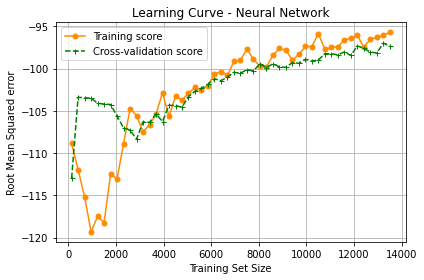

In [ ]:
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.plot(train_sizes, train_mean, color="darkorange", marker='o', markersize=5, label="Training score")
plt.plot(train_sizes, test_mean, color="green",marker='+', markersize=5, linestyle='--', label="Cross-validation score")

plt.title("Learning Curve - Neural Network")
plt.xlabel("Training Set Size"), plt.ylabel("Root Mean Squared error"), plt.legend(loc="best")
plt.grid()
plt.tight_layout()
plt.show()

Initially, a basic neural network is trained with a maximum iteration of 500 to check its performance. By analysing the model performance, neural networks predict the values approximately and in the same interval which avoids overfitting as overfitted  models cannot fit well on unseen data thus complicating the model to perform well on the test set. 

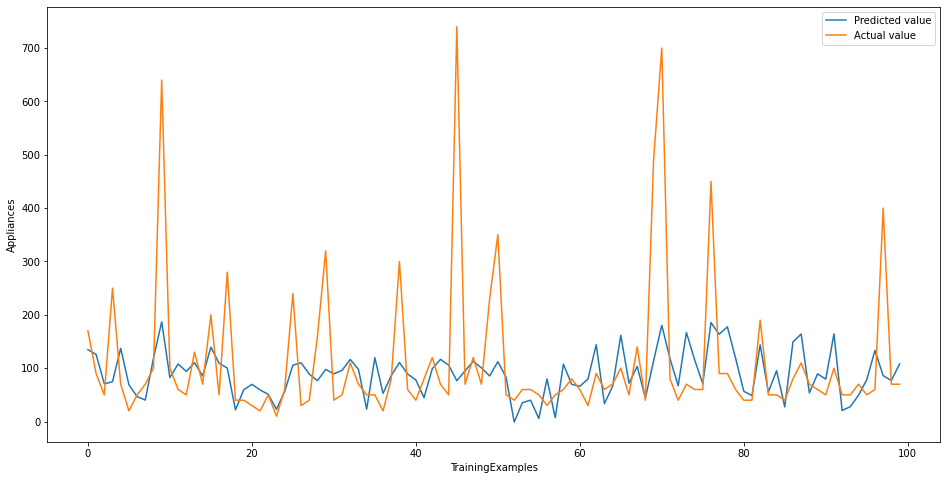

In [42]:
nn = MLPRegressor(random_state=1, max_iter=500)
model = nn.fit(x_train, r_train)
y_pred = model.predict(x_test)
test = pd.DataFrame({'Predicted value':y_pred, 'Actual value':r_test})
fig= plt.figure(figsize=(16,8))
test = test.reset_index()
test = test.drop(['index'],axis=1)
plt.plot(test[:100])
plt.xlabel('TrainingExamples')
plt.ylabel("Appliances")
plt.legend(['Predicted value','Actual value'])

The score of the evaluation metric is 95 and this error rate should further be minimised  by tuning its hyperparameters.

In [ ]:
print("Root Mean squared error (RMSE) of Neural Network: %.2f"
      % np.sqrt(mean_squared_error(r_test, y_pred)))

Root Mean squared error (RMSE) of Neural Network: 95.69


In [ ]:
predict = nn.predict(test_data)

In [ ]:
submission = pd.DataFrame(data=predict, columns=["Appliances"])
submission.index.name = "Id"
submission.head()

,Appliances
Id,
0,79.535047
1,80.797807
2,80.258603
3,80.744494
4,81.488909


In [ ]:
submission.to_csv(generate_unique_filename("nn", "csv"))

### Loss curve of Multi Layer Perceptron Regressor

The loss curve computes the training and test error over the number of iterations/epochs. The model seems to have a good learning rate and the cost reduces when the iteration is higher. Thus, when tuning the model the number of iterations is set to 300.

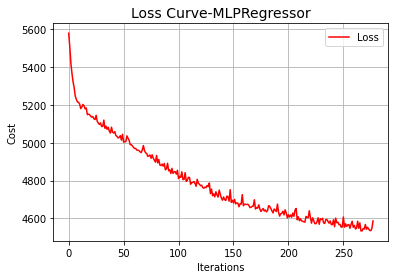

In [ ]:
#loss should be going down
plt.plot(nn.loss_curve_, color='red',label ="Loss")
plt.title("Loss Curve-MLPRegressor", fontsize=14)
plt.xlabel('Iterations')
plt.ylabel('Cost')
plt.legend()
plt.grid()
plt.show()

# Hyperparameter tuning of neural networks using gridsearch cv

Hyperparameter controls the overall performance of the models. It finds the optimal combination of parameters to reduce the error rates and find better results.

The main parameters to tune for neural networks are
- hidden layer sizes : A MLP regressor has an input layer, output layer and hidden layers. These layers are connected via nodes and form a network. Each hidden layer forms a weight to the input and directs them to the output using a non linear activation function.

- activation : The activation functions are responsible for transforming the weighted input into the output. 

- max_iter : The number of times data is passed through the algorithm. It was found to be 300 from the loss curve but it can still be computed in the gridsearch.

- solver: Solvers are used to optimize the parameters i.e to make the algorithm more efficient.

In [ ]:
param_grid = {
    'hidden_layer_sizes': [(150,100,50), (120,80,40), (100,50,30)],
    'max_iter': [50, 100, 300],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam']
}

In [ ]:
from sklearn.model_selection import GridSearchCV
grid = GridSearchCV(nn, param_grid, n_jobs= -1, cv=5, scoring = 'neg_root_mean_squared_error')
grid.fit(x_train, r_train)

GridSearchCV(cv=5, estimator=MLPRegressor(max_iter=500, random_state=1),
             n_jobs=-1,
             param_grid={'activation': ['tanh', 'relu'],
                         'hidden_layer_sizes': [(150, 100, 50), (120, 80, 40),
                                                (100, 50, 30)],
                         'max_iter': [50, 100, 300],
                         'solver': ['sgd', 'adam']},
             scoring='neg_root_mean_squared_error')

### The best parameter values for neural network from gridsearch that was used for the final model is as follows:

In [ ]:
grid.best_params_

{'activation': 'relu',
 'hidden_layer_sizes': (150, 100, 50),
 'max_iter': 300,
 'solver': 'adam'}

### After tuning the hyperparameters and fitting the model again, the rmse score is reduced which means that the performance of the model was good.

In [ ]:
y_pred = grid.predict(x_test)
print("Root Mean squared error (RMSE) of Neural Network after hyperparameter tuning: %.2f" % np.sqrt(mean_squared_error(r_test, y_pred)))

Root Mean squared error (RMSE) of Neural Network after hyperparameter tuning: 92.45


In [ ]:
grid_predictions = grid.predict(test_data) 
submission = pd.DataFrame(data=grid_predictions, columns=["Appliances"])
submission.index.name = "Id"
submission.head()

,Appliances
Id,
0,64.237759
1,64.885992
2,64.427457
3,64.485761
4,64.864668


In [ ]:
submission.to_csv(generate_unique_filename("nntuned1", "csv"))

## Model 2

# **Ridge Regression**

Ridge regression performs l2 regularization. As seen in the pairplot in the data analysis section many independent variables were highly correlated.  In this case, ridge regressor can be used to reduce multicollinearity. To reduce the standard error, ridge regressions adds bias to the regression estimates that helps to find the best estimates. A basic ridge regressor with alpha = 1 is trained to analyse the model. 

In [11]:
clf = Ridge(alpha=1.0)
clf.fit(x_train, r_train) 
y_pred = clf.predict(x_test)

The evaluation metric is found to be nearly 100 and to minise this, lets tune its hyper parameters

In [12]:
np.sqrt(mean_squared_error(y_pred,r_test))

99.59863055825834

In [ ]:
prediction = clf.predict(test_data)
len(prediction)

4735

In [ ]:
submission = pd.DataFrame(data=prediction, columns=["Appliances"])
submission.index.name = "Id"
submission.head()

,Appliances
Id,
0,97.882489
1,98.640211
2,98.104708
3,97.421277
4,97.794433


In [ ]:
submission.to_csv(generate_unique_filename("ridge", "csv"))

## Bias-Variance tradeoff for Ridge regressor

A learning curve will help understand the model if its underfitting or overfitting. The curve below after selecting important features shows that it is highly biased i.e the model is underfitting. Hence increasing the training samples can help the model to learn better.

In [21]:
X = train
y = target
train_sizes, train_scores, test_scores = learning_curve(Ridge(), X, y, cv=10, scoring='neg_root_mean_squared_error', 
                                                        n_jobs=-1, train_sizes=np.linspace(0.01, 1.0, 50))

### The RMSE of training score is higher than the validation score which conforms the model is not overfitting.

In [22]:
training_scores = np.mean(train_scores)
print('RMSE - Train Score:',training_scores)
valid_scores = np.mean(test_scores)
print('RMSE - Validation Score:',valid_scores)

RMSE - Train Score: -103.12935238576316
RMSE - Validation Score: -119.15792573080672


In [ ]:
X_train,X_val,y_train,y_val=train_test_split(train,target,test_size=0.25)
regressor=Ridge()
regressor.fit(X_train,y_train)
predictions=regressor.predict(X_val)

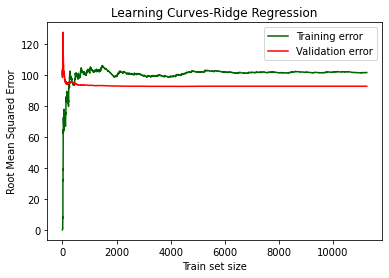

In [ ]:
train_errors=[]
val_errors=[]

for i in range(1,len(X_train)):
    regressor.fit(X_train[:i],y_train[:i])
    train_preds=regressor.predict(X_train[:i])
    val_preds=regressor.predict(X_val)
    train_errors.append(mse(train_preds,y_train[:i]))
    val_errors.append(mse(val_preds,y_val))
plt.plot(range(1,len(X_train)),np.sqrt(train_errors),color='darkgreen',label='Training error')
plt.plot(range(1,len(X_train)),np.sqrt(val_errors),color='red',label='Validation error')
plt.title('Learning Curves-Ridge Regression')    
plt.xlabel('Train set size')
plt.ylabel('Root Mean Squared Error')
plt.legend()
plt.show()

### Using Ridge Regressor without feature selection.

In [26]:
features = df_train.loc[:,['hour', 'T8', 'lights', 'T3', 'Press_mm_hg', 'RH_2', 'RH_3', 'T5', 'RH_5', 'T9', 'Tdewpoint','T1', 'RH_1', 'T2', 'T4', 'RH_4', 'T6', 'RH_6', 'T7', 
                       'RH_7','RH_8','RH_9', 'T_out', 'RH_out', 'Windspeed', 'Visibility','rv1','rv2']]
test = df_test.loc[:,['hour', 'T8', 'lights', 'T3', 'Press_mm_hg', 'RH_2', 'RH_3', 'T5', 'RH_5', 'T9', 'Tdewpoint','T1', 'RH_1', 'T2', 'T4', 'RH_4', 'T6', 'RH_6', 'T7', 
                        'RH_7','RH_8','RH_9', 'T_out', 'RH_out', 'Windspeed', 'Visibility','rv1','rv2']]
xx_train, xx_test, rr_train, rr_test = train_test_split(features, target, test_size = 0.25,random_state = 10)

In [ ]:
X_train,X_val,y_train,y_val=train_test_split(features,target,test_size=0.25)
regressor=Ridge()
regressor.fit(X_train,y_train)
predictions=regressor.predict(X_val)

### Since top features were not enough for the model to learn,  trying to increase the number of features made the curve converge at the rmse score of 100

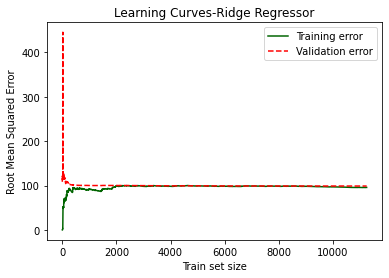

In [ ]:
# with all features
train_errors=[]
val_errors=[]

for i in range(1,len(X_train)):
    regressor.fit(X_train[:i],y_train[:i])
    train_preds=regressor.predict(X_train[:i])
    val_preds=regressor.predict(X_val)
    train_errors.append(mse(train_preds,y_train[:i]))
    val_errors.append(mse(val_preds,y_val))
plt.plot(range(1,len(X_train)),np.sqrt(train_errors),color='darkgreen',label='Training error')
plt.plot(range(1,len(X_train)),np.sqrt(val_errors),color='red',linestyle = '--', label='Validation error')
plt.title('Learning Curves-Ridge Regressor')    
plt.xlabel('Train set size')
plt.ylabel('Root Mean Squared Error')
plt.legend()
plt.show()

## Hyperparameter tuning using Gridsearchcv 

### Fine tuned ridge regressor has a kaggle score of 84.69

The parameters to tune for Ridge Regressor are
- alpha : Alpha is a regularisation function which tries to keep the parameters from overfitting. Here, alpha is tested in a range as follows and compared with the root mean squared error. The best alpha vaule is found to be 0.001 thus reducing the variance
 

In [26]:
alphas = [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1,0.5, 1]
for a in alphas:
    model = Ridge(alpha=a, normalize=True).fit(train,target) 
    score = model.score(train, target)
    pred_y = model.predict(train)
    mse = mean_squared_error(target, pred_y) 
    print("Alpha:{0:.6f}, RMSE:{1:.2f}".format(a, np.sqrt(mse)))

Alpha:0.000001, RMSE:99.65
Alpha:0.000010, RMSE:99.65
Alpha:0.000100, RMSE:99.65
Alpha:0.001000, RMSE:99.65
Alpha:0.010000, RMSE:99.65
Alpha:0.100000, RMSE:99.90
Alpha:0.500000, RMSE:101.02
Alpha:1.000000, RMSE:101.92


- normalize : If true, the regressors X will be normalized before regression by subtracting the mean and dividing by l2 norm. 

- solver : solver is used to make the computation effective and faster.

In [22]:
ridge = Ridge()
 
parameters = {
              'alpha': [0.001],
              'normalize': [True, False],
              'solver':["auto", "svd", "cholesky", "lsqr", "sparse_cg", "sag", "saga"]
              }
                      
ridge_grid = GridSearchCV(ridge, parameters, scoring = 'neg_root_mean_squared_error')
ridge_grid.fit(xx_train, rr_train)

GridSearchCV(estimator=Ridge(),
             param_grid={'alpha': [0.001], 'normalize': [True, False],
                         'solver': ['auto', 'svd', 'cholesky', 'lsqr',
                                    'sparse_cg', 'sag', 'saga']},
             scoring='neg_root_mean_squared_error')

### The final model is fitted with the following hyperparameter values:

In [18]:
ridge_grid.best_params_

{'alpha': 0.001, 'normalize': True, 'solver': 'sag'}

### The RMSE score is reduced from 100 to 96.82

In [19]:
y_pred=ridge_grid.predict(xx_test)
print("Root Mean squared error (RMSE) of Ridge Regression: %.2f" % np.sqrt(mean_squared_error(rr_test, y_pred)))

Root Mean squared error (RMSE) of Ridge Regression: 96.82


In [20]:
prediction = ridge_grid.predict(test)
submission = pd.DataFrame(data=prediction, columns=["Appliances"])
submission.index.name = "Id"
submission.head()

,Appliances
Id,
0,103.801128
1,102.870833
2,102.622118
3,104.888003
4,104.237572


In [ ]:
submission.to_csv(generate_unique_filename("rr", "csv"))

## Model 3

# Support Vector Regressor

SVR tries to find a best fit line between the vectors, where other regression models like ridge tries to reduce the error rates. Our target variable has outliers and SVR can be used since it is known to be robust to outliers.

### Support vector Regressor after tuning its paramters has a kaggle score of 85.59

## **Learning curve SVR**

In [23]:
X=train
y=target
train_sizes,training_scores, valid_scores = learning_curve(SVR(), 
                                                           X, y, cv=10, scoring="neg_root_mean_squared_error", 
                                                           n_jobs=1,train_sizes=np.linspace(0.01, 1.0, 50))

#### Since the RMSE value is in negative, validation score is higher than training score which indicates that the model is overfitting.

In [24]:
training_scores = np.mean(training_scores)
print('RMSE - Train Score:',training_scores)
valid_scores = np.mean(valid_scores)
print('RMSE - Validation Score:',valid_scores)

RMSE - Train Score: -120.75427997687358
RMSE - Validation Score: -113.23289698782168


#### The curve shows that the model has high variance and is overfitting as the validation accuracy is higher than training accuracy

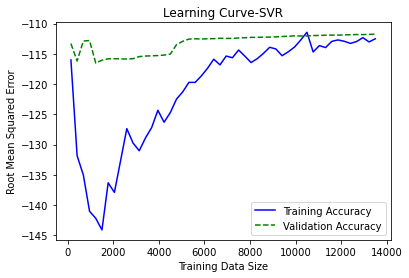

In [34]:
training_mean = np.mean(training_scores, axis=1)
training_std = np.std(training_scores, axis=1)
valid_mean = np.mean(valid_scores, axis=1)
valid_std = np.std(valid_scores, axis=1)

plt.plot(train_sizes, training_mean, color='blue', label='Training Accuracy')

plt.plot(train_sizes, valid_mean, color='green', linestyle='--', label='Validation Accuracy')

plt.title('Learning Curve-SVR')
plt.xlabel('Training Data Size')
plt.ylabel('Root Mean Squared Error')
plt.legend(loc='lower right')
plt.show()

## **Validation curve for SVR with respect to the parameter gamma** 

The gamma parameter defines how far the influence of a single training example reaches. Gamma was chosen as a validation parameter because initially the hyperparameters was tuned with gamma ='scale' and the best kernel was found to be polinomial. Since gamma is the Kernel coefficient for ‘rbf’, ‘poly’ and ‘sigmoid’., validation graph was created to get the appropriate gamma value.

Here, Gamma has been tested between 10<sup>-6</sup> and 10<sup>-1</sup> and the best gamma value is found to be between 10<sup>-4</sup> and 10<sup>-3</sup>. Hence when tuning the parameters for the final model the gamma value of 0.0001 has been used

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_split.py:680: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=10.
  UserWarning,


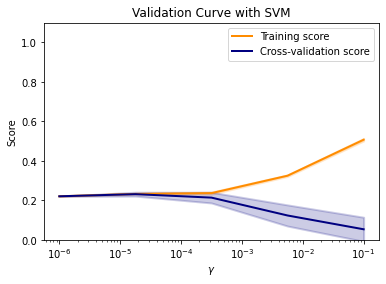

In [ ]:
X=train
y=target
param_range = np.logspace(-6, -1, 5)
train_scores, test_scores = validation_curve(
    SVR(), X, y, param_name="gamma", param_range=param_range,
    cv=10, scoring="accuracy", n_jobs=1)
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.title("Validation Curve with SVM")
plt.xlabel("$\gamma$")
plt.ylabel("Score")
plt.ylim(0.0, 1.1)
lw = 2
plt.semilogx(param_range, train_scores_mean, label="Training score",color="darkorange", lw=lw)
plt.fill_between(param_range, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2,
                 color="darkorange", lw=lw)
plt.semilogx(param_range, test_scores_mean, label="Cross-validation score",color="navy", lw=lw)
plt.fill_between(param_range, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2,
                 color="navy", lw=lw)
plt.legend(loc="best")
plt.show()

### Fitting a basic SVR model it is found that SVR before tuning the hyperparameters do not predict anything and the RMSE is very high

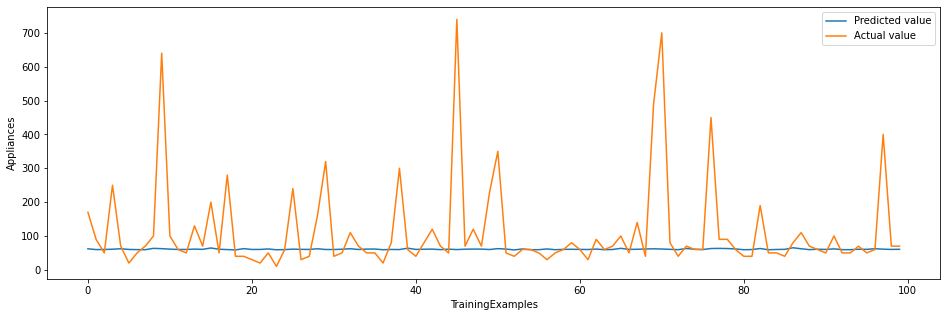

In [39]:
clf = SVR()
clf.fit(x_train, r_train)
y_pred = clf.predict(x_test)
test = pd.DataFrame({'Predicted value':y_pred, 'Actual value':r_test})
fig= plt.figure(figsize=(16,5))
test = test.reset_index()
test = test.drop(['index'],axis=1)
plt.plot(test[:100])
plt.xlabel('TrainingExamples')
plt.ylabel("Appliances")
plt.legend(['Predicted value','Actual value'])

In [40]:
np.sqrt(mean_squared_error(y_pred,r_test))

112.62906502127646

## **Hyperparameter tuning for SVR**

The hyperparameters to tune for SVR are
1) C : Regularisation parameter

2) kernel: Specifies the kernel type to be used in the algorithm.

3) epsilon : The value of epsilon determines the level of accuracy of the function.


After tuning the paramters , the RMSE score decreased from 112 to 99, which is a big difference and shows how gamma influences the performance of the model.

In [9]:
rf_params = {
    'C': [1,10,100],
    "kernel":['poly','rbf','sigmoid'],
    "epsilon":[0.01,0.1,1]
}
clf = SVR(gamma=0.0001)
grid = GridSearchCV(clf, rf_params, cv=10, scoring='neg_root_mean_squared_error')
grid.fit(x_train, r_train)
print(grid.best_params_)
print("RMSE:"+ str(-grid.best_score_))

{'C': 100, 'epsilon': 1, 'kernel': 'poly'}
RMSE:99.68253300885841


### The best hyperparameters for SVR are:
C = 100;
Epsilon = 1;
Kernel = poly

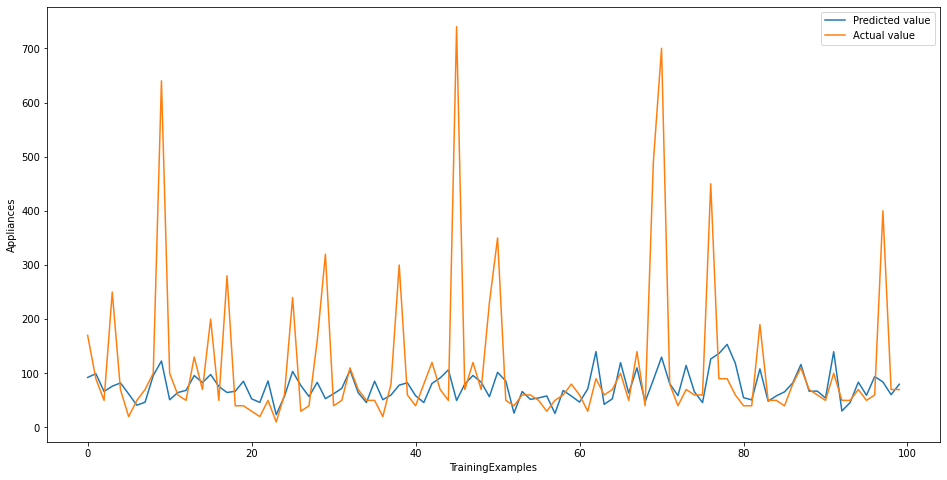

In [27]:
y_preds = grid.predict(x_test)
test = pd.DataFrame({'Predicted value':y_preds, 'Actual value':r_test})
fig= plt.figure(figsize=(16,8))
test = test.reset_index()
test = test.drop(['index'],axis=1)
plt.plot(test[:100])
plt.xlabel('TrainingExamples')
plt.ylabel('Appliances')
plt.legend(['Predicted value', 'Actual value'])

Before tuning, we found that the predicted values had a straight line,  after the influence of gamma the model predicted some values accurately but most in the same interval as seen in the plot above.

In [11]:
prediction = grid.predict(test_data)

In [17]:
submission = pd.DataFrame(data=prediction, columns=["Appliances"])
submission.index.name = "Id"
submission.head()

,Appliances
Id,
0,80.634928
1,80.817447
2,79.292209
3,80.341409
4,79.518025


In [18]:
submission.to_csv(generate_unique_filename("svrupdated", "csv"))

# References
https://towardsdatascience.com/random-forest-in-python-24d0893d51c0
https://pandas.pydata.org/docs/getting_started/intro_tutorials/09_timeseries.html

https://machinelearningmastery.com/regression-metrics-for-machine-learning/

https://practicaldatascience.co.uk/machine-learning/how-to-use-model-selection-and-hyperparameter-tuning